In [126]:
from __future__ import absolute_import
from __future__ import division
# from __future__ import print_function

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression as lm
#from sklearn.pipeline import Pipeline
#from sklearn.preprocessing import PolynomialFeatures
from sklearn import metrics
import tensorflow as tf

%matplotlib inline

### First, let's make future graphs prettie

In [127]:
plt.rc("font", size=14)
sns.set(style="white")
sns.set(style="whitegrid", color_codes=True)

### Then, read our data

In [128]:
data = pd.read_csv('C:\\Users\\Inna\\Documents\\0.DataScienceSchool\\FirstKernel_LinearReg\\insurance.csv')

### And make a quick glance on it: 

In [129]:
data.head()

,age,sex,bmi,children,smoker,region,charges
0,19,female,27.900,0,yes,southwest,16884.92400
1,18,male,33.770,1,no,southeast,1725.55230
2,28,male,33.000,3,no,southeast,4449.46200
3,33,male,22.705,0,no,northwest,21984.47061
4,32,male,28.880,0,no,northwest,3866.85520


# Peprocessing

#### Now let's handle categorical, non-numerical, variables such as "sex", "smoker" and "region". We will convert them into a format that machine learning models can process them

#### We are going to encode two-levels variables "sex" and "smoker", and create a one-hot vectors for the "region" variable, and also create two additional variables: "north" that will receive 1 for any northeren region and 0 for any southeren region, and "east" for eastern regions. 

In [130]:
# Create new columns that represent categorical data in the DataFrame
data['sex_num'] = data.sex.map({'female':1, 'male':0})
data['smoke_num'] = data.smoker.map({'yes':1, 'no':0})
# Add region north or south (1 for the north)
data['north'] = data['region'].apply(lambda x: 1 if (x == 'northwest' or x == 'northeast') else 0)
data['east'] = data['region'].apply(lambda x: 1 if (x == 'northeast' or x == 'southeast') else 0)

##### * Note that "female" is encoded as "1" and "male" as "2"

In [131]:
# One-hot vectors for different regions: 
# 1. create vectors of zeros: 
data_len = len(data['region'])
data['southwest'] = pd.Series(np.zeros(data_len), index = data.index)
data['southeast'] = pd.Series(np.zeros(data_len), index = data.index)
data['northwest'] = pd.Series(np.zeros(data_len), index = data.index)
data['northeast'] = pd.Series(np.zeros(data_len), index = data.index)

# 2. encode the data into these vectors acording to the regions: 
data['southwest'] = data['southwest'].where(data['region'] != 'southwest', 1)
data['southeast'] = data['southeast'].where(data['region'] != 'southeast', 1)
data['northwest'] = data['northwest'].where(data['region'] != 'northwest', 1)
data['northeast'] = data['northeast'].where(data['region'] != 'northeast', 1)

#### Let's look at our data again: 

In [132]:
data.head()

,age,sex,bmi,children,smoker,region,charges,sex_num,smoke_num,north,east,southwest,southeast,northwest,northeast
0,19,female,27.900,0,yes,southwest,16884.92400,1,1,0,0,1.0,0.0,0.0,0.0
1,18,male,33.770,1,no,southeast,1725.55230,0,0,0,1,0.0,1.0,0.0,0.0
2,28,male,33.000,3,no,southeast,4449.46200,0,0,0,1,0.0,1.0,0.0,0.0
3,33,male,22.705,0,no,northwest,21984.47061,0,0,1,0,0.0,0.0,1.0,0.0
4,32,male,28.880,0,no,northwest,3866.85520,0,0,1,0,0.0,0.0,1.0,0.0


# Summary of Data Exploration

#### 1. Smoking is highly correlated to medical costs
#### 2. Obesity also contributes to costs, but mostly when it appears with smoking
#### 3. Within the group of obese people who smoke, gender and residence may play a role also

## Let's build a prediction model now and calculate how this variables predict the outcome

# PREDICTION MODELS

In [133]:
data.head()

,age,sex,bmi,children,smoker,region,charges,sex_num,smoke_num,north,east,southwest,southeast,northwest,northeast
0,19,female,27.900,0,yes,southwest,16884.92400,1,1,0,0,1.0,0.0,0.0,0.0
1,18,male,33.770,1,no,southeast,1725.55230,0,0,0,1,0.0,1.0,0.0,0.0
2,28,male,33.000,3,no,southeast,4449.46200,0,0,0,1,0.0,1.0,0.0,0.0
3,33,male,22.705,0,no,northwest,21984.47061,0,0,1,0,0.0,0.0,1.0,0.0
4,32,male,28.880,0,no,northwest,3866.85520,0,0,1,0,0.0,0.0,1.0,0.0


# MODEL 1 - Multivariate Linear Regression with scikit-learn

####  Since region variables are related to each other, there could be a multi-collinearity problem. Let's measure collinearity. 
#### * Collinearity = independent variables are highly correlated. Therefore, it is hard to determine the real coefficients on each feature.

In [224]:
corrs = data.corr()
corrs

,age,bmi,children,charges,sex_num,smoke_num,north,east,southwest,southeast,northwest,northeast
age,1.000000,0.109272,0.042469,0.299008,0.020856,-0.025019,0.001772,-0.008245,0.010016,-0.011642,-0.000407,0.002475
bmi,0.109272,1.000000,0.012759,0.198341,-0.046371,0.003750,-0.235113,0.122011,-0.006205,0.270025,-0.135996,-0.138156
children,0.042469,0.012759,1.000000,0.067998,-0.017163,0.007673,0.001735,-0.040086,0.021914,-0.023066,0.024806,-0.022808
charges,0.299008,0.198341,0.067998,1.000000,-0.057292,0.787251,-0.028799,0.071314,-0.043210,0.073982,-0.039905,0.006349
sex_num,0.020856,-0.046371,-0.017163,-0.057292,1.000000,-0.076185,0.011651,-0.013162,0.004184,-0.017117,0.011156,0.002425
smoke_num,-0.025019,0.003750,0.007673,0.787251,-0.076185,1.000000,-0.029292,0.063400,-0.036945,0.068498,-0.036945,0.002811
north,0.001772,-0.235113,0.001735,-0.028799,0.011651,-0.029292,1.000000,-0.029071,-0.549730,-0.593313,0.583612,0.582426
east,-0.008245,0.122011,-0.040086,0.071314,-0.013162,0.063400,-0.029071,1.000000,-0.582740,0.594201,-0.582740,0.549435
southwest,0.010016,-0.006205,0.021914,-0.043210,0.004184,-0.036945,-0.549730,-0.582740,1.000000,-0.346265,-0.320829,-0.320177
southeast,-0.011642,0.270025,-0.023066,0.073982,-0.017117,0.068498,-0.593313,0.594201,-0.346265,1.000000,-0.346265,-0.345561


#### Indeed, there is high multi-collinearity between the regions variables (southeast, southwest, northest, northwest). Let's substitute these variables with variables "north" and "east" that includes the same information, but don't have high correlation between them. 
#### Other definitions of the model doesn't change. 

In [225]:
X = data[['age', 'sex_num', 'bmi', 'children', 'smoke_num', 'north', 'east']]
y = data['charges']

#### Cross-validation

In [226]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.3, random_state = 101)

In [227]:
model = lm().fit(X_train,y_train)
y_predicted = model.predict(X_test)

#### Let's evaluate the model using R-squared and an Adjusted R-squared metrics: 

In [228]:
# Bias
bias_m1 = round(model.score(X_train,y_train), 2)
bias_m1

0.75

In [229]:
# R^2, Variance
R_squared_m1 = round (metrics.r2_score(y_test, y_predicted), 2)
R_squared_m1

0.76

In [230]:
# define n, total number of observations, and k, total number of predictors for adjusted R squared calculation
n = X_test.shape[0]
k = X_test.shape[1]

In [231]:
adjusted_R_squared_m1 = round (1 - ((1 - R_squared_m1) * (n - 1) / (n - k - 1)) , 2)
adjusted_R_squared_m1

0.76

#### Calculate the last loss (MSE, mean square error)

In [232]:
last_loss_MSE_m1 = np.mean((np.subtract(y_predicted, y_test))**2)
round(last_loss_MSE_m1, 2)

33539431.18

### An adjusted R squared in slightly higher than in the previous model since there are fewer predictors

In [233]:
model.coef_

array([  240.93961612,   -55.43098346,   370.04053265,   494.64012026,
       23468.0663027 ,   824.85268746,    55.44063856])

#### Since collinearity does not affect our predictions, not a bias nor variance did not change. However,  weights of the regions variables are supposed to be more accurate in the second model compared to the first

### A correlation between actual Y and predicted Y

In [238]:
y_test.shape

(402,)

In [239]:
y_predicted.shape

(402,)

In [241]:
np.corrcoef(y_test, y_predicted)

array([[1.        , 0.87401087],
       [0.87401087, 1.        ]])

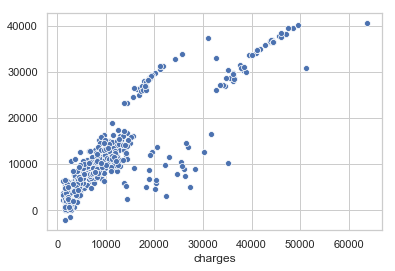

In [242]:
sns.scatterplot(y_test, y_predicted)

# MODEL 2 - Multiple Regression with Tensorflow

#### Model's Hyperparameters

In [144]:
learning_rate = 0.0001
# mean and standard deviation for W
mu = 0
sigma = 0.001 
split = 0.3
num_of_steps = 1000000

In [145]:
data.head()

,age,sex,bmi,children,smoker,region,charges,sex_num,smoke_num,north,east,southwest,southeast,northwest,northeast
0,19,female,27.900,0,yes,southwest,16884.92400,1,1,0,0,1.0,0.0,0.0,0.0
1,18,male,33.770,1,no,southeast,1725.55230,0,0,0,1,0.0,1.0,0.0,0.0
2,28,male,33.000,3,no,southeast,4449.46200,0,0,0,1,0.0,1.0,0.0,0.0
3,33,male,22.705,0,no,northwest,21984.47061,0,0,1,0,0.0,0.0,1.0,0.0
4,32,male,28.880,0,no,northwest,3866.85520,0,0,1,0,0.0,0.0,1.0,0.0


#### Prepare the data to the tensorflow format (numpy)

In [146]:
# converting the columns of the dataframe to numpy arrays
# X = data[['age', 'sex_num', 'bmi', 'children', 'smoke_num', 'north', 'east']]

x1 = data.age.to_numpy(dtype="float32")
x2 = data.sex_num.to_numpy(dtype="float32")/10
x3 = data.bmi.to_numpy(dtype="float32")
x4 = data.children.to_numpy(dtype="float32")
x5 = data.smoke_num.to_numpy(dtype="float32")
x6 = data.north.to_numpy(dtype="float32")
x7 = data.east.to_numpy(dtype="float32")

x_alldata = np.column_stack((x1, x2, x3, x4, x5, x6, x7))


y_alldata = data.charges.to_numpy(dtype="float32")

print('x & y_true all data shapes:', x_alldata.shape, y_alldata.shape)
print('x & y_true all data types:', x_alldata.dtype, y_alldata.dtype)
#print('num of features = ', k_features)

x & y_true all data shapes: (1338, 7) (1338,)
x & y_true all data types: float32 float32


#### Cross-validation

In [147]:
x_train, x_test, y_train, y_test = train_test_split(x_alldata, y_alldata, test_size = split, random_state=0)
# Split arrays or matrices into random train and test subsets

In [148]:
# 
n_datapoints = x_train.shape[0]
k_features = x_train.shape[1]
n_datapoints

936

In [149]:
# ADD DATA NORMALIZATION - ?

In [150]:
y_train.shape

(936,)

In [151]:
# make sure that each row of x corresponds to the same row as y
assert x_train.shape[0] == y_train.shape[0]
k_features

7

In [152]:
# Defining placeholders for x and y data according to its type and shape
x = tf.placeholder(tf.float32, [None, k_features], name = 'x')
y = tf.placeholder(tf.float32, [None, 1], name = 'y')

print('x:', x)
print('y:',y)

x: Tensor("x_3:0", shape=(?, 7), dtype=float32)
y: Tensor("y_3:0", shape=(?, 1), dtype=float32)


In [153]:
# Define the variables
with tf.variable_scope('lreg') as scope:
    w_values = np.random.normal(mu, sigma, [k_features, 1])
    w = tf.Variable(w_values, name = 'W', dtype=tf.float32) 
    b = tf.Variable(tf.zeros([1]), name = 'b', dtype=tf.float32) # b - all zeros
        
    # build the graph:
    # product = tf.matmul(x, w)
    y_predicted = tf.matmul(x, w) + b
    
    # compute the loss (squared): 
    loss = tf.reduce_mean(tf.square(y_predicted - y), name = 'loss')  # sum of all squared errors
    loss_sum = tf.summary.scalar("loss", loss) # ?
    
    # compute R squared and adjusted R squared: 
    y_mean = tf.reduce_mean(y)
    SSE = tf.reduce_mean((y - y_predicted)**2)
    SST = tf.reduce_mean((y - y_mean)**2)
    R_squared = 1 - SSE/SST
    
print('w', w, '\nx:', x, '\nb', b, 'y_predicted:', y_predicted, '\nloss:', loss)

w <tf.Variable 'lreg_3/W:0' shape=(7, 1) dtype=float32_ref> 
x: Tensor("x_3:0", shape=(?, 7), dtype=float32) 
b <tf.Variable 'lreg_3/b:0' shape=(1,) dtype=float32_ref> y_predicted: Tensor("lreg_3/add:0", shape=(?, 1), dtype=float32) 
loss: Tensor("lreg_3/loss:0", shape=(), dtype=float32)


In [154]:
# Add summary ops to collect data
#W_hist = tf.summary.histogram("weights", w)
#b_hist = tf.summary.histogram("biases", b)
#y_hist = tf.summary.histogram("y_predicted", y_predicted)

### Batch Gradient Descent

In [155]:
optimizer = tf.train.GradientDescentOptimizer(learning_rate).minimize(loss)  
# defines and computes backprop
print(optimizer)

name: "GradientDescent_3"
op: "NoOp"
input: "^GradientDescent_3/update_lreg_3/W/ApplyGradientDescent"
input: "^GradientDescent_3/update_lreg_3/b/ApplyGradientDescent"



In [156]:
init = tf.global_variables_initializer()   # initialization of the session
#print(init)

In [157]:
# TensorBoard
#writer = tf.summary.FileWriter('.')
#writer.add_graph(tf.get_default_graph())
#writer.flush()

# launch board in cmd >>>tensorboard --logdir .
# then go to the page http://localhost:6006/#graphs

In [158]:
# checking shapes & ranks
y_train = np.column_stack((y_train))
y_train = np.transpose(y_train)

print('y:', y, '\nx:', x)
print(y_train.shape, x_train.shape)
print('x_train shape:', x_train.shape, '\ntensor x shape:', x.shape)
print('y_train shape:', y_train.shape, '\ntensor y shape:', y.shape)
print('x rank: ', tf.rank(x), '\ny_predicted rank: ', tf.rank(y_predicted) , '\nw rank: ', tf.rank(w) , 
      '\nb rank: ', tf.rank(b))

y: Tensor("y_3:0", shape=(?, 1), dtype=float32) 
x: Tensor("x_3:0", shape=(?, 7), dtype=float32)
(936, 1) (936, 7)
x_train shape: (936, 7) 
tensor x shape: (?, 7)
y_train shape: (936, 1) 
tensor y shape: (?, 1)
x rank:  Tensor("Rank_8:0", shape=(), dtype=int32) 
y_predicted rank:  Tensor("Rank_9:0", shape=(), dtype=int32) 
w rank:  Tensor("Rank_10:0", shape=(), dtype=int32) 
b rank:  Tensor("Rank_11:0", shape=(), dtype=int32)


In [159]:
# x_test_ex = np.column_stack((x_test[1]))
# x_test_ex
x_test.shape
x_test[:,0]
print(y_predicted.shape)

(?, 1)


In [160]:
# ADD REGULARIZATION TO THE MODEL ?

In [161]:
# Running the session
# with tf.Session() as session: 

session = tf.Session()
session.run(init)

# Add ops to save and restore all the variables later
saver = tf.train.Saver()
        
feed_dict = {x: x_train, y: y_train}
    
# Traning the model: 
print('STARTS ITERATIONS...')
for step in range(num_of_steps): 
    loss_val, _ , R_squared_val = session.run([loss, optimizer, R_squared], feed_dict)        
    #print('step no. ', step, ', loss = ', loss_val.mean(), )
    #print('R squared = ', R_squared_val)

print('\nlast loss:', loss_val.mean())
print('# of iterations =', num_of_steps)
adjusted_R_squared = 1 - ( (1 - R_squared_val)*(n_datapoints - 1)/(n_datapoints - k_features - 1))
print('Adjust R squared for the train data = ', adjusted_R_squared)

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iterates...
iter

#### Reversed Normalization

In [187]:
reversedNorm = [1., 10., 1., 1., 1., 1., 1.]
reversedNorm = np.asarray(reversedNorm, dtype=np.float32)
reversedNorm = reversedNorm.reshape((1, 7), order='F')
#reversedNorm.flags
reversedNorm.shape

(1, 7)

#### Read last W and last b

In [188]:
w_model = session.run(w)
b_model = session.run(b)
    
print('w', w_model)
print('b', b_model)

predictions_train = session.run(tf.matmul(x_train, tf.matmul(w_model, reversedNorm)) + b_model)

predictions_test = session.run(tf.matmul (x_test, tf.matmul(w_model, reversedNorm)) + b_model)
predictions_test[:,0].shape

w [[  256.06265]
 [ -431.7304 ]
 [  329.13028]
 [  475.47754]
 [23370.465  ]
 [  596.69495]
 [  168.07326]]
b [-12595.053]


(402,)

#### Model Estimation

#### Calculate R^2 -- THERE IS A BUG HERE ...

In [189]:
predictions_test.shape

(402, 7)

In [196]:
# Reshape y_test
y_test_reshaped = y_test.reshape((len(y_test), 1), order='F')
y_test_reshaped.shape

(402, 1)

In [197]:
SSE_test = np.mean( (np.subtract(predictions_test, y_test_reshaped))**2)
SSE_test

8978232000.0

In [200]:
y_mean = np.mean(y_train)
SST_test = np.mean( (np.subtract(predictions_test, y_mean))**2)
# tf.reduce_mean((y - y_mean)**2)
SST_test

9378196000.0

In [201]:
SSE_test/SST_test

0.9573517

In [205]:
R_squared_test = 1 - SSE_test/SST_test
round(R_squared_test, 2)

0.04

In [206]:
adjusted_R_squared_test = 1 - ( (1 - R_squared_test)*(y_test.shape[0] - 1)/(y_test.shape[0] - k_features - 1))
round(adjusted_R_squared_test, 2)

0.03

In [111]:
y_train[:,0].shape

(936,)

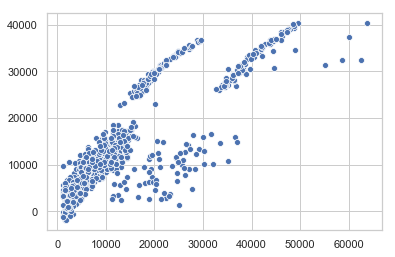

In [207]:
# Train data
sns.scatterplot(y_train[:,0], predictions_train[:,0])

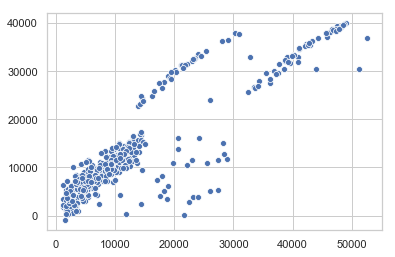

In [208]:
# Test data
sns.scatterplot(y_test, predictions_test[:,0])

In [209]:
# Train data
np.corrcoef(y_train[:,0], predictions_train[:,0])

array([[1.        , 0.85480615],
       [0.85480615, 1.        ]])

In [210]:
# Test data
np.corrcoef(y_test, predictions_test[:,0])

array([[1.        , 0.89062124],
       [0.89062124, 1.        ]])

In [211]:
# Save the variables to disk
saver = tf.train.Saver()

save_path = saver.save(session, '/tmp/model.ckpt')
print("Model saved in path: %s" % save_path)

Model saved in path: /tmp/model.ckpt


In [212]:
# Close he session
session.close()

#### Restore the model

INFO:tensorflow:Restoring parameters from /tmp/model.ckpt
Model restored.
w : [[  256.06265]
 [ -431.7304 ]
 [  329.13028]
 [  475.47754]
 [23370.465  ]
 [  596.69495]
 [  168.07326]]
b : [-12595.053]


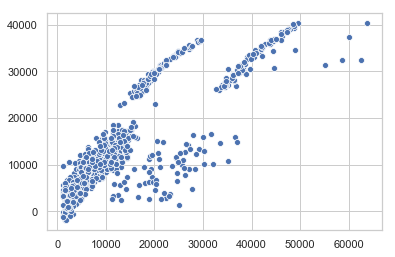

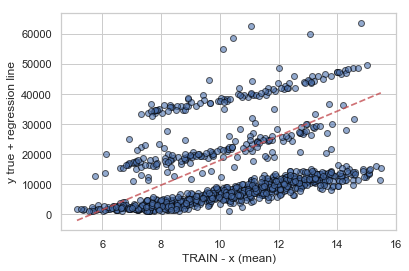

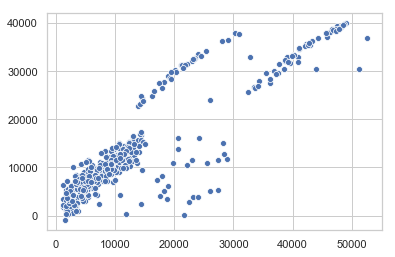

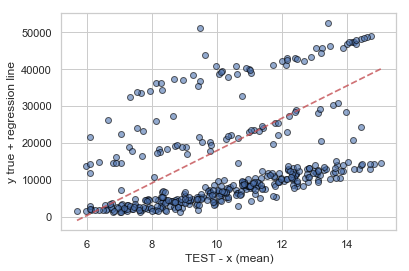

In [213]:
# Restore the model, calculate predictions again and plot the results

with tf.Session() as session:
    # Restore variables from disk
    saver.restore(session, "/tmp/model.ckpt")
    print("Model restored.")
    # Check the values of the variables
    print("w : %s" % w.eval())
    print("b : %s" % b.eval())
    
    predictions_train = session.run(tf.matmul(x_train, w) + b)
    predictions_test = session.run(tf.matmul(x_test, w) + b)
    
    x_train_mean = x_train.mean(axis = 1)
    x_test_mean = x_test.mean(axis = 1)

    # Plot 1 - train
    sns.scatterplot(y_train[:,0], predictions_train[:,0])
           
    # Plot 2 - train
    fig, ax = plt.subplots()
    ax.scatter(x_train_mean, y_train, edgecolors=(0, 0, 0), alpha = 0.6)
    ax.plot([x_train_mean.min(), x_train_mean.max()], 
            [predictions_train.min(), predictions_train.max()], 'r--', lw = 1.7, alpha = 0.8)
    ax.set_xlabel('TRAIN - x (mean)')
    ax.set_ylabel('y true + regression line')
    plt.show()
    
    # Plot 3 - test
    sns.scatterplot(y_test, predictions_test[:,0])
           
    # Plot 4 - test
    fig, ax = plt.subplots()
    ax.scatter(x_test_mean, y_test, edgecolors=(0, 0, 0), alpha = 0.6)
    ax.plot([x_test_mean.min(), x_test_mean.max()], [predictions_test.min(), predictions_test.max()], 'r--', lw = 1.7, alpha = 0.8)
    ax.set_xlabel('TEST - x (mean)')
    ax.set_ylabel('y true + regression line')
    plt.show()
    


In [214]:
y_train[:,0].shape

(936,)

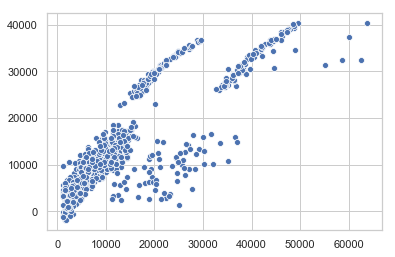

In [215]:
# Train data
sns.scatterplot(y_train[:,0], predictions_train[:,0])

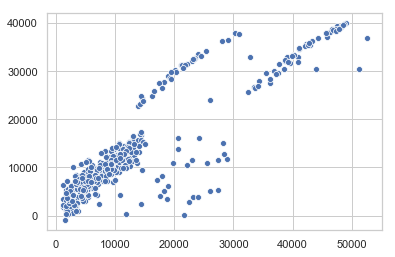

In [216]:
# Test data
sns.scatterplot(y_test, predictions_test[:,0])

In [217]:
# Train data
np.corrcoef(y_train[:,0], predictions_train[:,0])

array([[1.        , 0.85480615],
       [0.85480615, 1.        ]])

In [218]:
# Test data
np.corrcoef(y_test, predictions_test[:,0])

array([[1.        , 0.89062124],
       [0.89062124, 1.        ]])

In [220]:
# Close he session
session.close()

In [ ]:
# CALCULATE R^2 AND COMPARE MODELS
# ADD NORMALIZATION
# ADD REGULARIZATION TO TF MODEL BECAUSE W ARE VERY LARGE
# TRY NONLINEAR REGRESSION WITH TF